In [265]:
import pandas as pd

In [266]:
# LOAD dataset
cfd_df = pd.read_csv("apollo_cfd_database.csv")

# RENAME columns with corresponding names
new_col_names = {
    "X":"x",
    "Y":"y",
    "Z":"z",
    "pw (Pa)":"pressure",
    "qw (W/m^2)":"heat_flux",
    "Me": "edge_mach_number",
    "delta (m)": "boundary_layer_thickness",
    "theta (m)": "momentum_thickness",
    "Re-theta": "momentum_thickness_reynolds_number",
    "tauw (Pa)": "shear_stress",
    "mach (-)": "mach",
    "velocity (m/s)":"velocity",
    "density (kg/m^3)": "density",
    "aoa (degrees)": "angle_of_attack",
    "dynamic_pressure (Pa)":"dynamic_pressure"
    }
cfd_df.rename(columns=new_col_names, inplace=True)
cfd_df.head()

,x,y,z,pressure,heat_flux,edge_mach_number,boundary_layer_thickness,momentum_thickness,momentum_thickness_reynolds_number,shear_stress,mach,velocity,density,angle_of_attack,dynamic_pressure
0,0.017768,0.003489,-0.407755,64489.349983,497625.036467,0.454910,0.006833,0.000982,188.672182,39.628433,14.16745,4500.0,0.003851,154.0,38991.469837
1,0.018617,0.007022,-0.417330,64611.153940,498418.814300,0.451899,0.006820,0.000980,187.407496,39.410061,14.16745,4500.0,0.003851,154.0,38991.469837
2,0.015687,0.003484,-0.383248,64163.104160,495351.845000,0.462855,0.006867,0.000986,192.028006,40.138121,14.16745,4500.0,0.003851,154.0,38991.469837
3,0.016301,0.006972,-0.390625,64263.850973,496055.340900,0.460389,0.006857,0.000985,190.994027,39.990073,14.16745,4500.0,0.003851,154.0,38991.469837
4,0.014133,0.003485,-0.363827,63903.617037,493426.773433,0.469249,0.006893,0.000989,194.737028,40.464771,14.16745,4500.0,0.003851,154.0,38991.469837


In [267]:
# DEFINE independent and dependent variables
ind_var = ["velocity", "density", "angle_of_attack", "mach", "dynamic_pressure"]
dep_var = "pressure"

In [268]:
# FILTER independent and dependent from entire dataframe
filtered_df = cfd_df[ind_var + [dep_var]]

In [269]:
# GROUP by independent variables IMPORTANT!!!: There should be 185 rows
# grouped = (
#     filtered_df.groupby(ind_var)[dep_var]
#       .apply(lambda x: x.values)
#       .reset_index()
# )
skip = 50176
shield_dfs = [filtered_df.iloc[start:start+skip].reset_index(drop=True) for start in range(0, len(filtered_df), skip)]
shield_dfs[0]

,velocity,density,angle_of_attack,mach,dynamic_pressure,pressure
0,4500.0,0.003851,154.0,14.16745,38991.469837,64489.349983
1,4500.0,0.003851,154.0,14.16745,38991.469837,64611.153940
2,4500.0,0.003851,154.0,14.16745,38991.469837,64163.104160
3,4500.0,0.003851,154.0,14.16745,38991.469837,64263.850973
4,4500.0,0.003851,154.0,14.16745,38991.469837,63903.617037
...,...,...,...,...,...,...
50171,4500.0,0.003851,154.0,14.16745,38991.469837,2917.930921
50172,4500.0,0.003851,154.0,14.16745,38991.469837,2551.555545
50173,4500.0,0.003851,154.0,14.16745,38991.469837,2640.212016
50174,4500.0,0.003851,154.0,14.16745,38991.469837,2379.281886


In [270]:
grouped_dfs = []
for shield_df in shield_dfs:
    shield_grouped = (
        shield_df.groupby(ind_var, sort=False, as_index=False)
        .agg({dep_var: list})
    )
    grouped_dfs.append(shield_grouped)

In [271]:
grouped = pd.concat(grouped_dfs, ignore_index=True)
grouped

,velocity,density,angle_of_attack,mach,dynamic_pressure,pressure
0,4500.0,0.003851,154.0,14.167450,38991.469837,"[64489.349983333326, 64611.15394, 64163.104159..."
1,10500.0,0.000149,152.0,34.428650,8232.467608,"[13190.812790000002, 13219.685306666666, 13114..."
2,9000.0,0.000978,152.0,27.289638,39589.765294,"[63649.57315, 63787.35415333333, 63282.8567966..."
3,4500.0,0.001881,152.0,13.788210,19048.054327,"[30593.1142, 30657.275169999997, 30421.5128133..."
4,9500.0,0.000537,152.0,29.420906,24217.868842,"[38830.21700333333, 38915.33057333333, 38603.6..."
...,...,...,...,...,...,...
180,6500.0,0.000149,156.0,21.312974,3154.845864,"[5373.835048000001, 5383.063307, 5349.27372, 5..."
181,5500.0,0.000978,152.0,16.677001,14785.066669,"[23869.51594, 23918.90751, 23737.734686666667,..."
182,8500.0,0.000288,152.0,27.064293,10415.591115,"[16724.422479999997, 16760.48291, 16628.926936..."
183,9500.0,0.000537,154.0,29.420906,24217.868842,"[40071.33212, 40150.21431333333, 39861.0883199..."


In [272]:
# DEFINE Pytorch dataset
import numpy as np
import torch

class CFDSolutions(torch.utils.data.Dataset):
    def __init__(self, grouped_df):
        self.X = grouped_df[ind_var].values.astype('float32')
        self.Y = np.stack(grouped_df[dep_var].values).astype('float32')

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        return torch.from_numpy(self.X[idx]), torch.from_numpy(self.Y[idx])

In [273]:
# INITIALIZE dataset with Grouped data
dataset = CFDSolutions(grouped)

In [274]:
# TEST dataset, tensor X = [number of dependent variables], tensor Y = [50176 independent variables]
dataset[0]

(tensor([4.5000e+03, 3.8510e-03, 1.5400e+02, 1.4167e+01, 3.8991e+04]),
 tensor([64489.3516, 64611.1523, 64163.1055,  ...,  2640.2119,  2379.2820,
          2421.7090]))

In [289]:
# DEFINE model arquitecture
class ShieldModel(torch.nn.Module):
    def __init__(self):
        super(ShieldModel, self).__init__()
        self.linear1 = torch.nn.Linear(in_features = len(ind_var), out_features = 64)
        self.linear2 = torch.nn.Linear(in_features = 64, out_features = 128)
        self.linear3 = torch.nn.Linear(in_features = 128, out_features = 256)
        self.linear4 = torch.nn.Linear(in_features = 256, out_features = 50176)

    def forward(self, x):
        x = self.linear1(x)
        x = torch.nn.functional.relu(x)
        x = self.linear2(x)
        x = torch.nn.functional.relu(x)
        x = self.linear3(x)
        x = torch.nn.functional.relu(x)
        x = self.linear4(x)
        return x

In [290]:
# TEST model
dummy_batch = torch.zeros(10, len(ind_var))
my_model = ShieldModel()
predictions = my_model(dummy_batch)
print(dummy_batch.shape, predictions.shape)

torch.Size([10, 5]) torch.Size([10, 50176])


In [291]:
# DEFINE training loop
from torch.utils.data import DataLoader
import torch.optim as optim
from livelossplot import PlotLosses

def train_model(n_epochs, threshold, model, loss_fn, optimizer, scheduler, train_loader, val_loader, device):
    # for gpu training
    model = model.to(device)
    loss_fn = loss_fn.to(device)
    # for plotting
    liveloss = PlotLosses()
    for epoch in range(n_epochs):
        logs = {}
        # initialize control variables.
        correct = 0
        cumulative_loss = 0
        n_samples = 0
        # Set the model in training mode.
        model.train()
        for idx_batch, (X, y) in enumerate(train_loader):
            model.zero_grad()
            # Move (x,y) data to GPU (if so desired).
            X = X.to(device)
            y = y.to(device)
            # Compute predictions.
            pred = model(X)
            # Compute loss.
            loss = loss_fn(pred, y)
            cumulative_loss += loss.item()
            # Count how many correct in batch.
            pred_placeholder = pred.detach()
            percent_diff_each = (pred_placeholder - y).abs() / y.abs() * 100
            mean_percent_diff = percent_diff_each.mean(dim=1)
            mask = mean_percent_diff < threshold
            correct += mask.sum().cpu().item()
            n_samples += mask.size(0)
            # Compute gradients (autograd).
            loss.backward()
            # Run one basic training step of SGD.
            optimizer.step()
            # Keep track of loss and accuracy for the plot.
            n_batches = 1 + idx_batch
            logs['loss'] = cumulative_loss / n_batches
            logs['accuracy'] = correct / n_samples
        # initialize control variables.
        correct = 0
        cumulative_loss = 0
        n_samples = 0
        # Set the model in evaluation mode.
        model.eval()
        with torch.no_grad():
            for idx_batch, (X, y) in enumerate(val_loader):
                # Move data to GPU if needed.
                X = X.to(device)
                y = y.to(device)
                # Compute predictions.
                pred = model(X)
                # Compute loss.
                loss = loss_fn(pred, y)
                cumulative_loss += loss.item()
                # Count how many correct in batch.
                pred_placeholder = pred.detach()
                percent_diff_each = (pred_placeholder - y).abs() / y.abs() * 100
                mean_percent_diff = percent_diff_each.mean(dim=1)
                mask = mean_percent_diff < threshold
                correct += mask.sum().cpu().item()
                n_samples += mask.size(0)
                # Keep track of loss and accuracy for the plot.
                n_batches = 1 + idx_batch
                logs['val_loss'] = cumulative_loss / n_batches
                logs['val_accuracy'] = correct / n_samples
        # Update the plot with new logging information.
        liveloss.update(logs)
        liveloss.send()

        if scheduler != -1:
            scheduler.step()

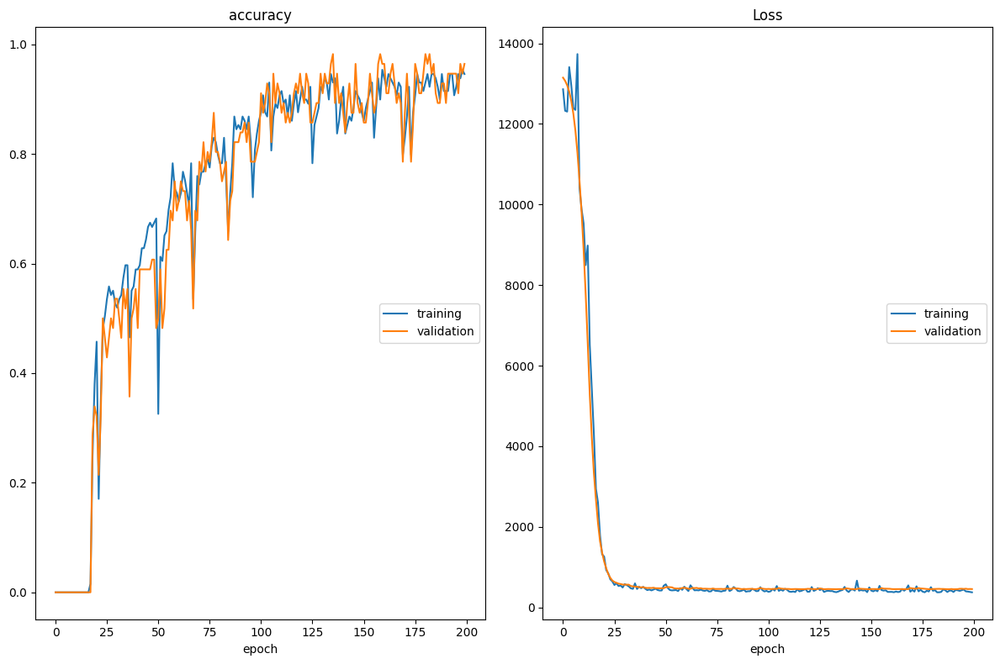

accuracy
	training         	 (min:    0.000, max:    0.953, cur:    0.946)
	validation       	 (min:    0.000, max:    0.982, cur:    0.964)
Loss
	training         	 (min:  373.274, max: 13734.753, cur:  373.274)
	validation       	 (min:  448.599, max: 13149.652, cur:  453.955)


In [304]:
# DEFINE training parameters
from sklearn.model_selection import train_test_split
from torch.optim import lr_scheduler

train_df, val_df = train_test_split(grouped, test_size=0.30, random_state=42)

n_epochs = 200
batch_size = 16
lr = 0.0001
threshold = 10

train_set = CFDSolutions(train_df)
val_set = CFDSolutions(val_df)

train_loader = DataLoader(train_set, batch_size, shuffle=True)
val_loader = DataLoader(val_set, batch_size, shuffle=False)

model = ShieldModel()
loss_fn = torch.nn.SmoothL1Loss()
optimizer = optim.Adam(model.parameters(), lr)
device = torch.device("mps")
scheduler = lr_scheduler.StepLR(optimizer, step_size=100, gamma=0.5)

train_model(n_epochs, threshold, model, loss_fn, optimizer, scheduler, train_loader, val_loader, device)

In [305]:
# SAMPLE 1 of 185 point for testing
idx_sample = 1
x_sample = grouped.loc[idx_sample, ind_var].to_numpy(dtype='float32')
y_sample = grouped.loc[idx_sample, dep_var]
x_sample_tensor = torch.tensor([x_sample], dtype=torch.float32).to(device)

In [306]:
# TEST 1 sample with model
model.eval()
with torch.no_grad():
    prediction = model(x_sample_tensor).squeeze(0).cpu().numpy()
print(prediction)
print(y_sample)

[13626.416   13609.857   13485.566   ...   502.45755   443.05914
   480.54916]
[13190.812790000002, 13219.685306666666, 13114.02127, 13137.639516666668, 13052.774563333332, 13071.31329, 13002.817216666668, 13018.26278, 12959.990996666667, 12973.40575, 12921.984703333334, 12933.97938, 12887.315656666668, 12898.31593, 12854.90613, 12865.230126666667, 12823.923053333332, 12833.822953333334, 12793.671916666666, 12803.365976666666, 12763.52885, 12773.218916666669, 12732.879846666669, 12742.772896666667, 12701.06746, 12711.392153333334, 12667.24434, 12678.31906, 12630.931403333334, 12642.845173333331, 12591.46023, 12604.516196666666, 12549.05019, 12563.007416666664, 12505.550526666668, 12519.62622, 12461.92758, 12476.044483333331, 12418.155223333331, 12432.367916666668, 12374.15268, 12388.476276666668, 12329.897453333331, 12344.338036666668, 12285.376296666667, 12299.939313333334, 12240.57064, 12255.264093333331, 12195.487846666669, 12210.30495, 12150.130846666669, 12165.073686666668, 12104.

In [307]:
print(type(np.array(y_sample)))

<class 'numpy.ndarray'>


In [308]:
percent_diff_each = np.abs(prediction - np.array(y_sample)) / np.abs(np.array(y_sample)) * 100
mean_percent_diff = percent_diff_each.mean()
mean_percent_diff

9.067716268433994

In [309]:
# COLLECT coordiantes for ploting
xyz_df = cfd_df[["x", "y", "z"]].iloc[0:50176]

In [310]:
# ATTACH correct and prediction
xyz_df["correct"] = y_sample
xyz_df["prediction"] = prediction
xyz_df["percent_difference"] = np.abs(prediction - np.array(y_sample)) / np.abs(np.array(y_sample)) * 100

In [311]:
xyz_df

,x,y,z,correct,prediction,percent_difference
0,0.017768,0.003489,-0.407755,13190.812790,13626.416016,3.302323
1,0.018617,0.007022,-0.417330,13219.685307,13609.857422,2.951448
2,0.015687,0.003484,-0.383248,13114.021270,13485.566406,2.833190
3,0.016301,0.006972,-0.390625,13137.639517,13503.006836,2.781073
4,0.014133,0.003485,-0.363827,13052.774563,13460.826172,3.126168
...,...,...,...,...,...,...
50171,0.649148,0.015809,-1.931491,728.931477,541.249451,25.747554
50172,0.655325,0.031553,-1.927749,643.354219,491.582153,23.590747
50173,0.653792,0.015788,-1.928851,663.935058,502.457550,24.321281
50174,0.659870,0.031508,-1.924942,603.400519,443.059143,26.572960


In [312]:
# PLOT correct points
import plotly.express as px

fig = px.scatter_3d(
    xyz_df,
    x="x",
    y="y",
    z="z",
    color="correct",
    color_continuous_scale="Viridis" ,
    hover_data=xyz_df.columns
)

fig.show()

In [313]:
# PLOT predicted points
fig = px.scatter_3d(
    xyz_df,
    x="x",
    y="y",
    z="z",
    color="prediction",
    color_continuous_scale="Viridis" ,
    hover_data=xyz_df.columns
)

fig.show()

In [314]:
# PLOT diffrence points
fig = px.scatter_3d(
    xyz_df,
    x="x",
    y="y",
    z="z",
    color="percent_difference",
    color_continuous_scale="Viridis" ,
    range_color=[1, 100],
    hover_data=xyz_df.columns
)

fig.show()